# Visualizing Text Data

[Women's E-Commerce Clothing Reviews](https://www.kaggle.com/datasets/nicapotato/womens-ecommerce-clothing-reviews)

__Content__

_This dataset includes 23486 rows and 10 feature variables. Each row corresponds to a customer review, and includes the variables:_

* Clothing ID: Integer Categorical variable that refers to the specific piece being reviewed.
* Age: Positive Integer variable of the reviewers age.
* Title: String variable for the title of the review.
* Review Text: String variable for the review body.
* Rating: Positive Ordinal Integer variable for the product score granted by the customer from 1 Worst, to 5 Best.
* Recommended IND: Binary variable stating where the customer recommends the product where 1 is recommended, 0 is not recommended.
* Positive Feedback Count: Positive Integer documenting the number of other customers who found this review positive.
* Division Name: Categorical name of the product high level division.
* Department Name: Categorical name of the product department name.
* Class Name: Categorical name of the product class name.


In [18]:
import json
import cufflinks as cf
import matplotlib.pyplot as plt
import nltk
import numpy as np
import pandas as pd
import plotly as py
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob

In [2]:
from contractions import contractions

In [3]:
from plotly.offline import iplot
py.offline.init_notebook_mode(connected=True)
cf.go_offline()

## Dataset

In [10]:
! wget 'https://github.com/ya-stack/Women-s-Ecommerce-Clothing-Reviews/raw/master/Womens%20Clothing%20E-Commerce%20Reviews.csv' -P dataset

--2023-05-12 19:00:53--  https://github.com/ya-stack/Women-s-Ecommerce-Clothing-Reviews/raw/master/Womens%20Clothing%20E-Commerce%20Reviews.csv
Loaded CA certificate '/etc/ssl/certs/ca-certificates.crt'
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/ya-stack/Women-s-Ecommerce-Clothing-Reviews/master/Womens%20Clothing%20E-Commerce%20Reviews.csv [following]
--2023-05-12 19:00:53--  https://raw.githubusercontent.com/ya-stack/Women-s-Ecommerce-Clothing-Reviews/master/Womens%20Clothing%20E-Commerce%20Reviews.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8483448 (8.1M) [text/plain]
Saving to:

In [4]:
reviews_df = pd.read_csv('dataset/Womens_Clothing_E-Commerce_Reviews.csv')
reviews_df.head(5)

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


|  | Unnamed: 0 | Clothing ID | Age | Title | Review Text | Rating | Recommended IND | Positive Feedback Count | Division Name | Department Name | Class Name |
| -- | -- | -- | -- | -- | -- | -- | -- | -- | -- | -- | -- |
| 0 | 0 | 767 | 33 | NaN | Absolutely wonderful - silky and sexy and comf... | 4 | 1 | 0 | Initmates | Intimate | Intimates |
| 1 | 1 | 1080 | 34 | NaN | Love this dress! it's sooo pretty. i happene... | 5 | 1 | 4 | General | Dresses | Dresses |
| 2 | 2 | 1077 | 60 | Some major design flaws | I had such high hopes for this dress and reall... | 3 | 0 | 0 | General | Dresses | Dresses |
| 3 | 3 | 1049 | 50 | My favorite buy! | I love, love, love this jumpsuit. it's fun, fl... | 5 | 1 | 0 | General Petite | Bottoms | Pants |
| 4 | 4 | 847 | 47 | Flattering shirt | This shirt is very flattering to all due to th... | 5 | 1 | 6 | General | Tops | Blouses |

### Data Cleaning

In [5]:
reviews_df_drop= reviews_df.drop(labels=['Unnamed: 0', 'Clothing ID', 'Title'], axis=1)
reviews_df_drop.head(5)

,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


| | Age | Review Text | Rating | Recommended IND | Positive Feedback Count | Division Name | Department Name | Class Name |
| -- | -- | -- | -- | -- | -- | -- | -- | -- |
| 0 | 33 | Absolutely wonderful - silky and sexy and comf... | 4 | 1 | 0 | Initmates | Intimate | Intimates |
| 1 | 34 | Love this dress! it's sooo pretty. i happene... | 5 | 1 | 4 | General | Dresses | Dresses |
| 2 | 60 | I had such high hopes for this dress and reall... | 3 | 0 | 0 | General | Dresses | Dresses |
| 3 | 50 | I love, love, love this jumpsuit. it's fun, fl... | 5 | 1 | 0 | General Petite | Bottoms | Pants |
| 4 | 47 | This shirt is very flattering to all due to th... | 5 | 1 | 6 | General | Tops | Blouses |

In [6]:
reviews_df_drop.sum(numeric_only=True)

Age                        1014561
Rating                       98548
Recommended IND              19314
Positive Feedback Count      59559
dtype: int64

|    |    |
| -- | -- |
| Age | 1014561 |
| Rating | 98548 |
| Recommended IND | 19314 |
| Positive Feedback Count | 59559 |
_dtype: int64_

In [7]:
reviews_df_drop.dropna(subset=['Review Text', 'Division Name'], inplace=True)

In [8]:
reviews_df_drop.sum(numeric_only=True)

Age                        979405
Rating                      94655
Recommended IND             18527
Positive Feedback Count     59552
dtype: int64

### Remove Contractions

In [9]:
' '.join(reviews_df_drop['Review Text'].tolist())

'Absolutely wonderful - silky and sexy and comfortable Love this dress!  it\'s sooo pretty.  i happened to find it in a store, and i\'m glad i did bc i never would have ordered it online bc it\'s petite.  i bought a petite and am 5\'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c I love, love, love this jumpsuit. it\'s fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments! This shirt

In [9]:
def expand_contractions(x):
    if type(x) is str:
        # remove backslashes
        x = x.replace('\\', '')
        # expand contractions
        for key in contractions:
            value = contractions[key]
            x = x.replace(key, value)
        return x
    else:
        return x

In [9]:
# test function on text
x = "y'all it\'s sooo pretty, i am 5\' 5\'\', about 135"
print(expand_contractions(x))
# you all it is sooo pretty, i am 5' 5'', about 135

you all it is sooo pretty, i am 5' 5'', about 135


In [14]:
# test on a dataframe
string_series = pd.Series([
    "i\'m glad i did bc  it\'s never...",
    "I\'m 5\"5\' and ain't 125 lbs."
], dtype="string")

string_df = pd.DataFrame({'strings':string_series.values})
string_df['strings'].apply(lambda x: expand_contractions(x)).head(2)

# 0    I am glad i did because  it is never...
# 1              I am 5"5' and is not 125 lbs.
# Name: strings, dtype: object

0    I am glad i did because  it is never...
1              I am 5"5' and is not 125 lbs.
Name: strings, dtype: object

In [10]:
reviews_df_expanded = reviews_df_drop.copy()
reviews_df_expanded['Review Text'] = reviews_df_drop['Review Text'].apply(
    lambda x: expand_contractions(x)
)

In [11]:
' '.join(reviews_df_expanded['Review Text'].tolist())

'Absolutely wonderful - silky and sexy and comfortable Love this dress!  it is sooo pretty.  i happened to find it in a store, and I am glad i did because i never would have ordered it online because it is petite.  i bought a petite and am 5\'8".  i love the length on me- hits just a little below the knee.  would definitely be a true midi on someone who is truly petite. I had such high hopes for this dress and really wanted it to work for me. i initially ordered the petite small (my usual size) but i found this to be outrageously small. so small in fact that i could not zip it up! i reordered it in petite medium, which was just ok. overall, the top half was comfortable and fit nicely, but the bottom half had a very tight under layer and several somewhat cheap (net) over layers. imo, a major design flaw was the net over layer sewn directly into the zipper - it c I love, love, love this jumpsuit. it is fun, flirty, and fabulous! every time i wear it, i get nothing but great compliments! 

## Feature Engineering

In [11]:
reviews_df_expanded['Polarity'] = reviews_df_expanded['Review Text'].apply(
    lambda x: TextBlob(x).sentiment.polarity
)

In [12]:
reviews_df_expanded['Review Length'] = reviews_df_expanded['Review Text'].apply(
    lambda x: len(x)
)

In [13]:
reviews_df_expanded['Word Count'] = reviews_df_expanded['Review Text'].apply(
    lambda x: len(x.split())
)

In [14]:
def get_avg_word_len(x):
    words = x.split()
    word_len = 0
    for word in words:
        word_len = word_len + len(word)
        
    return word_len/len(words)

In [15]:
reviews_df_expanded['Average Word Length'] = reviews_df_expanded['Review Text'].apply(
    lambda x: get_avg_word_len(x)
)

In [16]:
reviews_df_expanded.head(5)

,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,Polarity,Review Length,Word Count,Average Word Length
0,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,0.633333,53,8,5.750000
1,34,Love this dress! it is sooo pretty. i happen...,5,1,4,General,Dresses,Dresses,0.339583,316,65,3.800000
2,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,0.073675,500,98,4.112245
3,50,"I love, love, love this jumpsuit. it is fun, f...",5,1,0,General Petite,Bottoms,Pants,0.550000,125,23,4.478261
4,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,0.512891,192,36,4.361111


|   | Age | Review Text | Rating | Recommended IND | Positive Feedback Count | Division Name | Department Name | Class Name | Polarity | Review Length | Word Count | Average Word Length |
| -- | -- | -- | -- | -- | -- | -- | -- | -- | -- | -- | -- | -- |
| 0 | 33 | Absolutely wonderful - silky and sexy and comf... | 4 | 1 | 0 | Initmates | Intimate | Intimates | 0.633333 | 53 | 8 | 5.750000 |
| 1 | 34 | Love this dress! it is sooo pretty. i happen... | 5 | 1 | 4 | General | Dresses | Dresses | 0.339583 | 316 | 65 | 3.800000 |
| 2 | 60 | I had such high hopes for this dress and reall... | 3 | 0 | 0 | General | Dresses | Dresses | 0.073675 | 500 | 98 | 4.112245 |
| 3 | 50 | I love, love, love this jumpsuit. it is fun, f... | 5 | 1 | 0 | General Petite | Bottoms | Pants | 0.550000 | 125 | 23 | 4.478261 |
| 4 | 47 | This shirt is very flattering to all due to th... | 5 | 1 | 6 | General | Tops | Blouses | 0.512891 | 192 | 36 | 4.361111 |

### Numerical Plots

#### Sentiment Polarity

In [35]:
reviews_df_expanded['Polarity'].iplot(
    title='Sentiment Polarity',
    theme='polar',
    yTitle='Sentiment [-1,1]',
    xTitle='Reviews'    
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_01.webp)

In [38]:
reviews_df_expanded['Polarity'].iplot(
    kind='hist',
    title='Sentiment Polarity',
    theme='polar',
    xTitle='Sentiment [-1,1]',
    yTitle='Frequency'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_02.webp)

#### Ratings vs. Age

In [41]:
reviews_df_expanded['Rating'].iplot(
    kind='hist',
    theme='polar',
    title='Rating Histogram',
    xTitle='Rating',
    yTitle='Frequency'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_03.webp)

In [47]:
reviews_df_expanded['Age'].iplot(
    kind='hist',
    theme='polar',
    title='Age Histogram',
    xTitle='Age',
    yTitle='Frequency'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_04.webp)

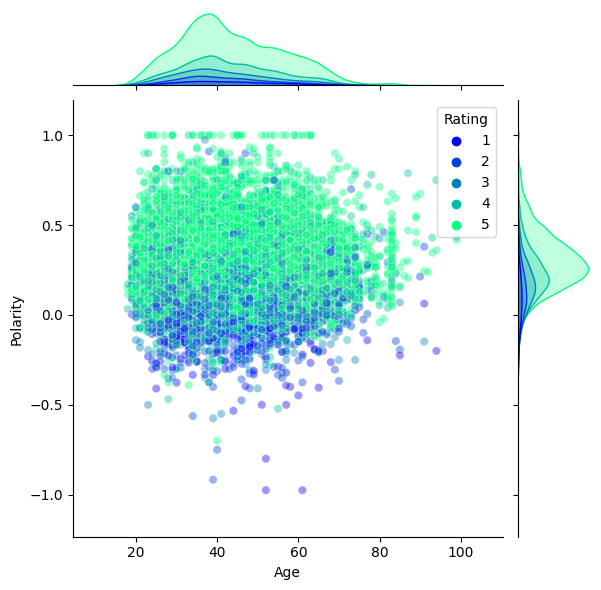

In [54]:
sns.jointplot(
    data=reviews_df_expanded,
    x='Age',
    y='Polarity',
    kind='scatter',
    hue='Rating',
    palette='winter',
    alpha=0.4
)

plt.savefig('../assets/E-Commerce_Clothing_Reviews_05.webp', bbox_inches='tight')

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_05.webp)

### Word Count vs Average Word Length

In [50]:
reviews_df_expanded['Word Count'].iplot(
    kind='hist',
    theme='polar',
    title='Word Count',
    xTitle='Word Count',
    yTitle='Frequency'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_06.webp)

In [51]:
reviews_df_expanded['Average Word Length'].iplot(
    kind='hist',
    theme='polar',
    title='Average Word Length',
    xTitle='Average Word Length',
    yTitle='Frequency'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_07.webp)

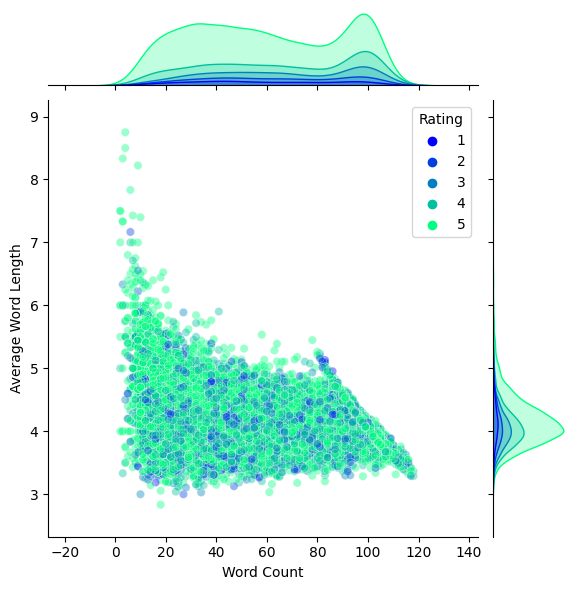

In [53]:
sns.jointplot(
    data=reviews_df_expanded,
    x='Word Count',
    y='Average Word Length',
    kind='scatter',
    hue='Rating',
    palette='winter',
    alpha=0.4
)

plt.savefig('../assets/E-Commerce_Clothing_Reviews_08.webp', bbox_inches='tight')

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_08.webp)

### Categorical Plots

#### Department, Division and Class

In [60]:
departments = reviews_df_expanded['Department Name'].value_counts()
divisions = reviews_df_expanded['Division Name'].value_counts()
classes = reviews_df_expanded['Class Name'].value_counts()

Dresses           6145
Knits             4626
Blouses           2983
Sweaters          1380
Pants             1350
Jeans             1104
Fine gauge        1059
Skirts             903
Jackets            683
Lounge             669
Swim               332
Outerwear          319
Shorts             304
Sleep              214
Legwear            158
Intimates          147
Layering           132
Trend              118
Casual bottoms       1
Chemises             1
Name: Class Name, dtype: int64

| Class Names | Count | Division Name | Count | Department Name | Count |
| -- | -- | -- | -- | -- | -- |
| Dresses | 6145 | Tops | 10048 | General | 13365 |
| Knits | 4626 | Dresses | 6145 | General Petite | 7837 |
| Blouses | 2983 | Bottoms | 3662 | Initmates | 1426 |
| Sweaters | 1380 | Intimate | 1653 |
| Pants | 1350 | Jackets | 1002 |
| Jeans | 1104 | Trend | 118 |
| Fine gauge | 1059 |
| Skirts | 903 |
| Jackets | 683 |
| Lounge | 669 |
| Swim | 332 |
| Outerwear | 319 |
| Shorts | 304 |
| Sleep | 214 |
| Legwear | 158 |
| Intimates | 147 |
| Layering | 132 |
| Trend | 118 |
| Casual bottoms | 1 |
| Chemises | 1 |
_Name: Class Name, dtype: int64_

In [62]:
reviews_df_expanded['Department Name'].value_counts().iplot(
    kind='bar',
    theme='polar',
    title='Reviews by Department',
    xTitle='Departments',
    yTitle='Review Count'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_09.webp)

In [63]:
reviews_df_expanded['Division Name'].value_counts().iplot(
    kind='bar',
    theme='polar',
    title='Reviews by Division',
    xTitle='Division',
    yTitle='Review Count'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_10.webp)

In [64]:
reviews_df_expanded['Class Name'].value_counts().iplot(
    kind='bar',
    theme='polar',
    title='Reviews by Class',
    xTitle='Class',
    yTitle='Review Count'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_11.webp)

### Unigram, Bigram and Trigram

#### Get Top Words Function

In [78]:
# pre-processing example - get word frequency from string
x = ['i would have, you would have ordered it online because it is petite.  i bought a petite and am 5\'8\".']
vec = CountVectorizer().fit(x)
vec.vocabulary_.items()

# vocabulary items and position
# dict_items([('would', 10), ('have', 4), ('you', 11), ('ordered', 8), ('it', 6), ('online', 7), ('because', 2), ('is', 5), ('petite', 9), ('bought', 3), ('and', 1), ('am', 0)])

dict_items([('would', 10), ('have', 4), ('you', 11), ('ordered', 8), ('it', 6), ('online', 7), ('because', 2), ('is', 5), ('petite', 9), ('bought', 3), ('and', 1), ('am', 0)])

In [88]:
words = vec.transform(x)
words_sum = words.sum(axis=0)
words_sum

# frequency of words (correlates to position index above)
# matrix([[1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1]])

matrix([[1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 2, 1]])

In [94]:
word_frequency = []

for word, idx in vec.vocabulary_.items():
    word_frequency.append((word, words_sum[0, idx]))
    
word_frequency = sorted(word_frequency, key=lambda x: x[1], reverse=True)

word_frequency
# [('would', 2),
#  ('have', 2),
#  ('it', 2),
#  ('petite', 2),
#  ('you', 1),
#  ('ordered', 1),
#  ('online', 1),
#  ('because', 1),
#  ('is', 1),
#  ('bought', 1),
#  ('and', 1),
#  ('am', 1)]

[('would', 2),
 ('have', 2),
 ('it', 2),
 ('petite', 2),
 ('you', 1),
 ('ordered', 1),
 ('online', 1),
 ('because', 1),
 ('is', 1),
 ('bought', 1),
 ('and', 1),
 ('am', 1)]

In [138]:
def get_ngrams_by_frequency(nrange, data, n):
    # ngram_range : tuple (min_n, max_n), default=(1, 1)
    vec = CountVectorizer(ngram_range=nrange).fit(data)
    vec.vocabulary_.items()
    
    words = vec.transform(data)
    words_sum = words.sum(axis=0)
    
    word_frequency = []

    for word, idx in vec.vocabulary_.items():
        word_frequency.append((word, words_sum[0, idx]))

    top_words = sorted(word_frequency, key=lambda data: data[1], reverse=True)
    
    return top_words[:n]

In [139]:
# return 5 top words
get_ngrams_by_frequency((1, 1), x, 5)
# [('would', 2), ('have', 2), ('it', 2), ('petite', 2), ('you', 1)]

[('would', 2), ('have', 2), ('it', 2), ('petite', 2), ('you', 1)]

#### Unigrams Feature Extraction

In [142]:
top_20_unigrams = get_ngrams_by_frequency(
    nrange=(1, 1),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_unigrams_df = pd.DataFrame(top_20_unigrams, columns=['Unigram', 'Frequency'])
top_20_unigrams_df = top_20_unigrams_df.set_index('Unigram')
top_20_unigrams_df

,Frequency
Unigram,
the,76159
it,49162
and,48993
is,37696
this,25758
to,24592
in,20722
not,18781
but,16549


| Unigram | Frequency |
| -- | -- |
| the | 76159 |
| it | 49162 |
| and | 48993 |
| is | 37696 |
| this | 25758 |
| to | 24592 |
| in | 20722 |
| not | 18781 |
| but | 16549 |
| on | 15325 |
| for | 13994 |
| of | 13472 |
| was | 12923 |
| with | 12797 |
| so | 12017 |
| am | 11625 |
| my | 11027 |
| dress | 10561 |
| that | 9560 |
| love | 8945 |

In [150]:
top_20_unigrams_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Unigrams',
    yTitle='Frequency',
    xTitle='Unigram'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_12.webp)

#### Bigrams Feature Extraction

In [147]:
top_20_bigrams = get_ngrams_by_frequency(
    nrange=(2, 2),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_bigrams_df = pd.DataFrame(top_20_bigrams, columns=['Bigram', 'Frequency'])
top_20_bigrams_df = top_20_bigrams_df.set_index('Bigram')
top_20_bigrams_df

,Frequency
Bigram,
it is,12528
in the,7169
and the,5611
this dress,4755
on the,4337
of the,3933
and it,3723
it was,3287
does not,3228


| Bigram | Frequency |
| -- | -- |
| it is | 12528 |
| in the | 7169 |
| and the | 5611 |
| this dress | 4755 |
| on the | 4337 |
| of the | 3933 |
| and it | 3723 |
| it was | 3287 |
| does not | 3228 |
| this top | 2937 |
| this is | 2772 |
| is very | 2725 |
| the fabric | 2653 |
| love the | 2641 |
| did not | 2486 |
| love this | 2331 |
| to wear | 2266 |
| but it | 2196 |
| the dress | 2178 |
| do not | 2118 |

In [151]:
top_20_bigrams_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Bigrams',
    yTitle='Frequency',
    xTitle='Bigram'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_13.webp)

#### Trigrams Feature Extraction

In [154]:
top_20_trigrams = get_ngrams_by_frequency(
    nrange=(3, 3),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_trigrams_df = pd.DataFrame(top_20_trigrams, columns=['Trigram', 'Frequency'])
top_20_trigrams_df = top_20_trigrams_df.set_index('Trigram')
top_20_trigrams_df

,Frequency
Trigram,
do not does,1759
not does not,1758
true to size,1316
the fabric is,1301
and it is,1124
this dress is,1123
it is very,976
but it is,921
it is not,910


| Trigram | Frequency |
| -- | -- |
| do not does | 1759 |
| not does not | 1758 |
| true to size | 1316 |
| the fabric is | 1301 |
| and it is | 1124 |
| this dress is | 1123 |
| it is very | 976 |
| but it is | 921 |
| it is not | 910 |
| the material is | 896 |
| if you are | 733 |
| in the store | 728 |
| on the model | 722 |
| the fit is | 696 |
| this top is | 672 |
| the color is | 630 |
| love this dress | 603 |
| it is so | 585 |
| tried it on | 574 |
| and it was | 550 |

In [155]:
top_20_trigrams_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Trigrams',
    yTitle='Frequency',
    xTitle='Trigram'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_14.webp)

#### Removing Stop Words

In [157]:
def get_ngrams_no_stop_by_frequency(nrange, data, n):
    # ngram_range : tuple (min_n, max_n), default=(1, 1)
    vec = CountVectorizer(ngram_range=nrange, stop_words='english').fit(data)
    vec.vocabulary_.items()
    
    words = vec.transform(data)
    words_sum = words.sum(axis=0)
    
    word_frequency = []

    for word, idx in vec.vocabulary_.items():
        word_frequency.append((word, words_sum[0, idx]))

    top_words = sorted(word_frequency, key=lambda data: data[1], reverse=True)
    
    return top_words[:n]

In [158]:
top_20_unigrams_no_stop = get_ngrams_no_stop_by_frequency(
    nrange=(1, 1),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_unigrams_no_stop_df = pd.DataFrame(top_20_unigrams_no_stop, columns=['Unigram', 'Frequency'])
top_20_unigrams_no_stop_df = top_20_unigrams_no_stop_df.set_index('Unigram')

top_20_unigrams_no_stop_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Unigrams',
    yTitle='Frequency',
    xTitle='Unigram'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_15.webp)

In [159]:
top_20_bigrams_no_stop = get_ngrams_no_stop_by_frequency(
    nrange=(2, 2),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_bigrams_no_stop_df = pd.DataFrame(top_20_bigrams_no_stop, columns=['Bigram', 'Frequency'])
top_20_bigrams_no_stop_df = top_20_bigrams_no_stop_df.set_index('Bigram')

top_20_bigrams_no_stop_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Bigrams',
    yTitle='Frequency',
    xTitle='Bigram'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_16.webp)

In [160]:
top_20_trigrams_no_stop = get_ngrams_no_stop_by_frequency(
    nrange=(3, 3),
    data=reviews_df_expanded['Review Text'],
    n=20
)

top_20_trigrams_no_stop_df = pd.DataFrame(top_20_trigrams_no_stop, columns=['Bigram', 'Frequency'])
top_20_trigrams_no_stop_df = top_20_trigrams_no_stop_df.set_index('Bigram')

top_20_trigrams_no_stop_df.iplot(
    kind='bar',
    theme='polar',
    title='Top 20 Trigrams',
    yTitle='Frequency',
    xTitle='Trigrams'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_17.webp)

### Parts-of-Speech (PoS-Tags)

In [166]:
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')
nltk.download('tagsets')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/xiaodie/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt to /home/xiaodie/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package tagsets to /home/xiaodie/nltk_data...
[nltk_data]   Unzipping help/tagsets.zip.


True

In [168]:
blob = TextBlob(str(reviews_df_expanded['Review Text']))
pos_df = pd.DataFrame(blob.tags, columns=['Words', 'PoS'])
pos_df

,Words,PoS
0,0,CD
1,Absolutely,RB
2,wonderful,JJ
3,silky,NN
4,and,CC
...,...,...
106,Text,NNP
107,Length,NNP
108,22628,CD
109,dtype,NN


|  | Words | PoS |
| -- | -- | -- |
| 0 | 0 | CD |
| 1 | Absolutely | RB |
| 2 | wonderful | JJ |
| 3 | silky | NN |
| 4 | and | CC |
_..._
| 106 | Text | NNP |
| 107 | Length | NNP |
| 108 | 22628 | CD |
| 109 | dtype | NN |
| 110 | object | NN |
_111 rows × 2 columns_

In [167]:
nltk.help.upenn_tagset()

$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or

```
$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or conjunction, subordinating
    astride among uppon whether out inside pro despite on by throughout
    below within for towards near behind atop around if like until below
    next into if beside ...
JJ: adjective or numeral, ordinal
    third ill-mannered pre-war regrettable oiled calamitous first separable
    ectoplasmic battery-powered participatory fourth still-to-be-named
    multilingual multi-disciplinary ...
JJR: adjective, comparative
    bleaker braver breezier briefer brighter brisker broader bumper busier
    calmer cheaper choosier cleaner clearer closer colder commoner costlier
    cozier creamier crunchier cuter ...
JJS: adjective, superlative
    calmest cheapest choicest classiest cleanest clearest closest commonest
    corniest costliest crassest creepiest crudest cutest darkest deadliest
    dearest deepest densest dinkiest ...
LS: list item marker
    A A. B B. C C. D E F First G H I J K One SP-44001 SP-44002 SP-44005
    SP-44007 Second Third Three Two * a b c d first five four one six three
    two
MD: modal auxiliary
    can cannot could couldn't dare may might must need ought shall should
    shouldn't will would
NN: noun, common, singular or mass
    common-carrier cabbage knuckle-duster Casino afghan shed thermostat
    investment slide humour falloff slick wind hyena override subhumanity
    machinist ...
NNP: noun, proper, singular
    Motown Venneboerger Czestochwa Ranzer Conchita Trumplane Christos
    Oceanside Escobar Kreisler Sawyer Cougar Yvette Ervin ODI Darryl CTCA
    Shannon A.K.C. Meltex Liverpool ...
NNPS: noun, proper, plural
    Americans Americas Amharas Amityvilles Amusements Anarcho-Syndicalists
    Andalusians Andes Andruses Angels Animals Anthony Antilles Antiques
    Apache Apaches Apocrypha ...
NNS: noun, common, plural
    undergraduates scotches bric-a-brac products bodyguards facets coasts
    divestitures storehouses designs clubs fragrances averages
    subjectivists apprehensions muses factory-jobs ...
PDT: pre-determiner
    all both half many quite such sure this
POS: genitive marker
    ' 's
PRP: pronoun, personal
    hers herself him himself hisself it itself me myself one oneself ours
    ourselves ownself self she thee theirs them themselves they thou thy us
PRP$: pronoun, possessive
    her his mine my our ours their thy your
RB: adverb
    occasionally unabatingly maddeningly adventurously professedly
    stirringly prominently technologically magisterially predominately
    swiftly fiscally pitilessly ...
RBR: adverb, comparative
    further gloomier grander graver greater grimmer harder harsher
    healthier heavier higher however larger later leaner lengthier less-
    perfectly lesser lonelier longer louder lower more ...
RBS: adverb, superlative
    best biggest bluntest earliest farthest first furthest hardest
    heartiest highest largest least less most nearest second tightest worst
RP: particle
    aboard about across along apart around aside at away back before behind
    by crop down ever fast for forth from go high i.e. in into just later
    low more off on open out over per pie raising start teeth that through
    under unto up up-pp upon whole with you
SYM: symbol
    % & ' '' ''. ) ). * + ,. < = > @ A[fj] U.S U.S.S.R * ** ***
TO: "to" as preposition or infinitive marker
    to
UH: interjection
    Goodbye Goody Gosh Wow Jeepers Jee-sus Hubba Hey Kee-reist Oops amen
    huh howdy uh dammit whammo shucks heck anyways whodunnit honey golly
    man baby diddle hush sonuvabitch ...
VB: verb, base form
    ask assemble assess assign assume atone attention avoid bake balkanize
    bank begin behold believe bend benefit bevel beware bless boil bomb
    boost brace break bring broil brush build ...
VBD: verb, past tense
    dipped pleaded swiped regummed soaked tidied convened halted registered
    cushioned exacted snubbed strode aimed adopted belied figgered
    speculated wore appreciated contemplated ...
VBG: verb, present participle or gerund
    telegraphing stirring focusing angering judging stalling lactating
    hankerin' alleging veering capping approaching traveling besieging
    encrypting interrupting erasing wincing ...
VBN: verb, past participle
    multihulled dilapidated aerosolized chaired languished panelized used
    experimented flourished imitated reunifed factored condensed sheared
    unsettled primed dubbed desired ...
VBP: verb, present tense, not 3rd person singular
    predominate wrap resort sue twist spill cure lengthen brush terminate
    appear tend stray glisten obtain comprise detest tease attract
    emphasize mold postpone sever return wag ...
VBZ: verb, present tense, 3rd person singular
    bases reconstructs marks mixes displeases seals carps weaves snatches
    slumps stretches authorizes smolders pictures emerges stockpiles
    seduces fizzes uses bolsters slaps speaks pleads ...
WDT: WH-determiner
    that what whatever which whichever
WP: WH-pronoun
    that what whatever whatsoever which who whom whosoever
WP$: WH-pronoun, possessive
    whose
WRB: Wh-adverb
    how however whence whenever where whereby whereever wherein whereof why
``: opening quotation mark
    ` ``
```

In [171]:
pos_df = pos_df['PoS'].value_counts()
pos_df

NN     23
DT     15
JJ     13
CD     11
PRP     8
RB      6
VBZ     5
VBP     5
IN      5
CC      4
NNP     4
VBD     4
TO      3
NNS     2
VB      2
PDT     1
Name: PoS, dtype: int64

|  |  |
| -- | -- |
| NN | 23 |
| DT | 15 |
| JJ | 13 |
| CD | 11 |
| PRP | 8 |
| RB  | 6 |
| VBZ | 5 |
| VBP | 5 |
| IN  | 5 |
| CC  | 4 |
| NNP | 4 |
| VBD | 4 |
| TO  | 3 |
| NNS | 2 |
| VB  | 2 |
| PDT | 1 |
_Name: PoS, dtype: int64_

In [172]:
pos_df.iplot(
    kind='bar',
    theme='polar',
    title='Parts-of-Speech',
    yTitle='Count',
    xTitle='Tags'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_18.webp)

### Bivariant Analysis

#### Pairplot

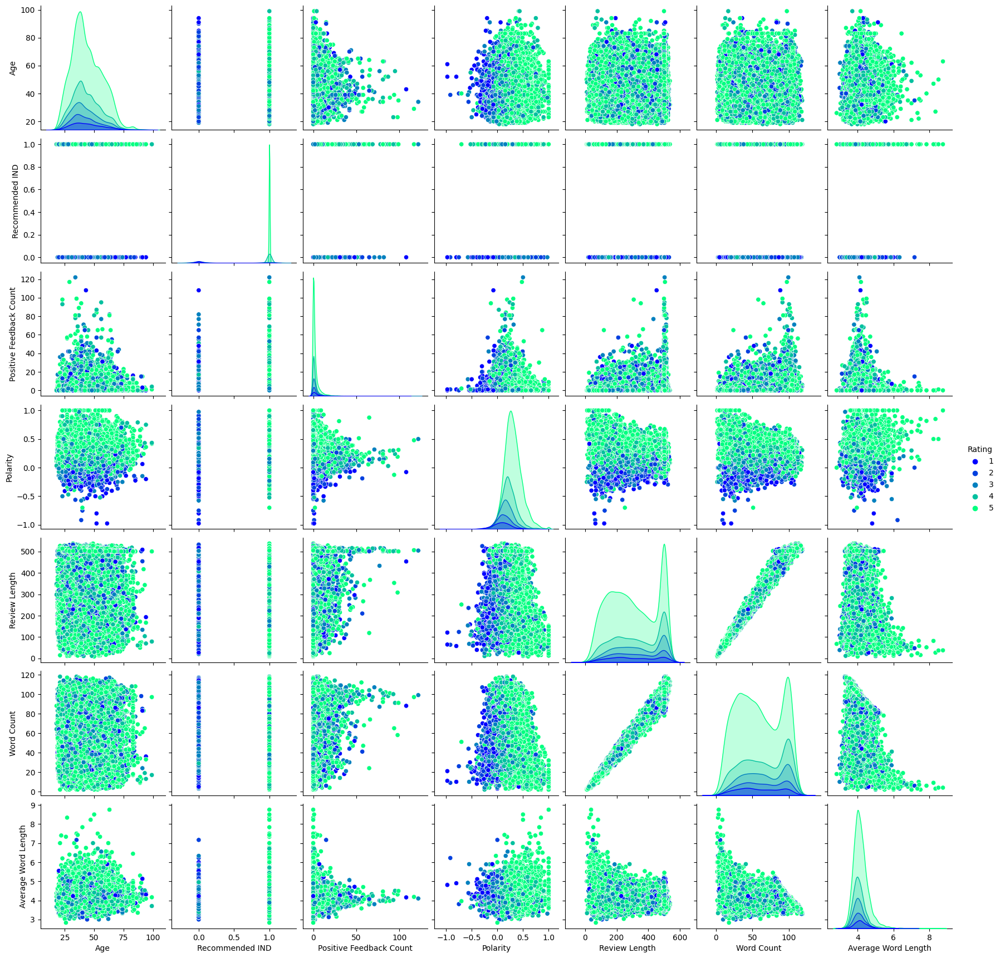

In [176]:
sns.pairplot(
    data=reviews_df_expanded,
    hue='Rating',
    palette='winter'
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_19.webp)

#### Swarm Plot - Polarity by Department Name

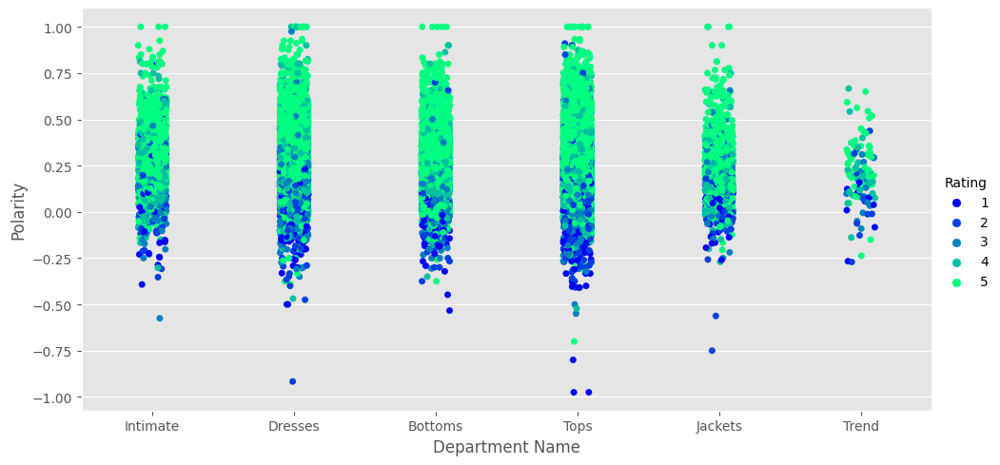

In [188]:
plt.rcParams['figure.figsize'] = [10,5]

sns.catplot(
    data=reviews_df_expanded,
    x='Department Name',
    y='Polarity',
    hue='Rating',
    palette='winter',
    height=5,
    aspect=2
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_20.webp)

#### Boxen Plot - Polarity by Department Name

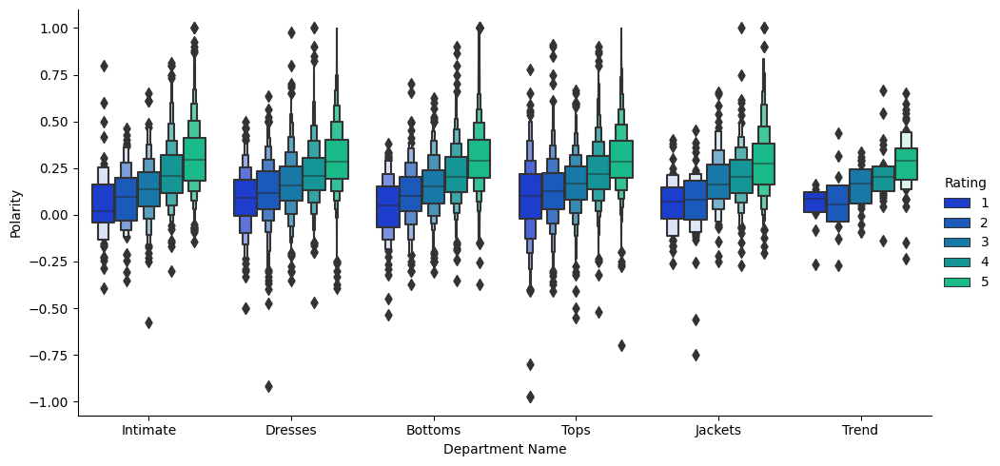

In [46]:
sns.catplot(
    kind='boxen',
    data=reviews_df_expanded,
    x='Department Name',
    y='Polarity',
    hue='Rating',
    palette='winter',
    height=5,
    aspect=2
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_21.webp)

#### Box Plot - Review Length by Deparment Name

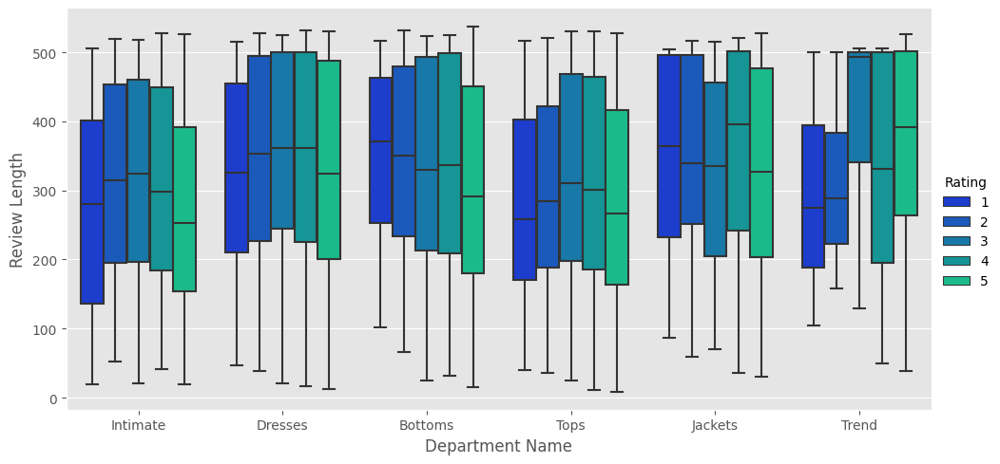

In [190]:
sns.catplot(
    kind='box',
    data=reviews_df_expanded,
    x='Department Name',
    y='Review Length',
    hue='Rating',
    palette='winter',
    height=5,
    aspect=2
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_22.webp)

#### Recommendation Sentiment Polarity Distribution

In [39]:
recommended_ps = reviews_df_expanded[reviews_df_expanded['Recommended IND']==1]['Polarity']
recommended_ps.head(5)

0    0.633333
1    0.339583
3    0.550000
4    0.512891
6    0.133750
Name: Polarity, dtype: float64

|  | Polarity |
| -- | -- |
| 0 | 0.633333 |
| 1 | 0.339583 |
| 3 | 0.550000 |
| 4 | 0.512891 |
| 6 | 0.133750 |

In [40]:
not_recommended_ps = reviews_df_expanded[reviews_df_expanded['Recommended IND']==0]['Polarity']
not_recommended_ps.head(5)

2     0.073675
5     0.178750
10   -0.097149
22   -0.045595
25    0.261508
Name: Polarity, dtype: float64

|  | Polarity |
| -- | -- |
| 2 | 0.073675 |
| 5 | 0.178750 |
| 10 | -0.097149 |
| 22 | -0.045595 |
| 25 | 0.261508 |

In [43]:
trace_pos = go.Histogram(x=recommended_ps, name='Recommended', opacity=0.8)
trace_neg = go.Histogram(x=not_recommended_ps, name='Not Recommended', opacity=0.8)

data = [trace_pos, trace_neg]
layout = go.Layout(barmode='overlay', title='Recommendation Sentiment Polarity Distribution')

fig=go.Figure(data=data, layout=layout)
fig.data[0].marker.color = ('mediumspringgreen')
fig.data[1].marker.color = ('dodgerblue')
iplot(fig)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_23.webp)

#### Recommendation Rating Distribution

In [48]:
recommended_rating_ps = reviews_df_expanded[reviews_df_expanded['Recommended IND']==1]['Rating']
not_recommended_rating_ps = reviews_df_expanded[reviews_df_expanded['Recommended IND']==0]['Rating']

In [52]:
trace_pos_rating = go.Histogram(x=recommended_rating_ps, name='Recommended', opacity=0.3)
trace_neg_rating = go.Histogram(x=not_recommended_rating_ps, name='Not Recommended', opacity=0.3)

data2 = [trace_pos_rating, trace_neg_rating]
layout2 = go.Layout(barmode='overlay', title='Recommendation Rating Distribution')

fig=go.Figure(data=data2, layout=layout2)
fig.data[0].marker.color = ('mediumspringgreen')
fig.data[1].marker.color = ('dodgerblue')
iplot(fig)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_24.webp)

#### Joint Plot

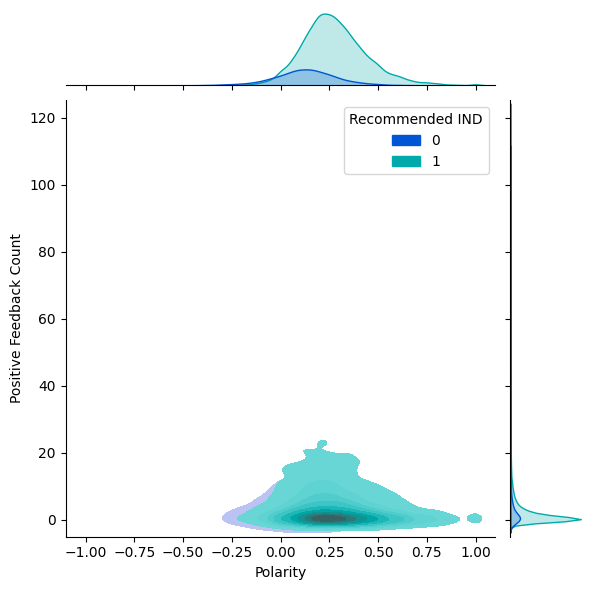

In [63]:
sns.jointplot(
    data=reviews_df_expanded,
    y='Positive Feedback Count',
    x='Polarity',
    hue='Recommended IND',
    palette='winter',
    kind='kde',
    fill=True
)

![Visualizing Text Data](../assets/E-Commerce_Clothing_Reviews_25.webp)